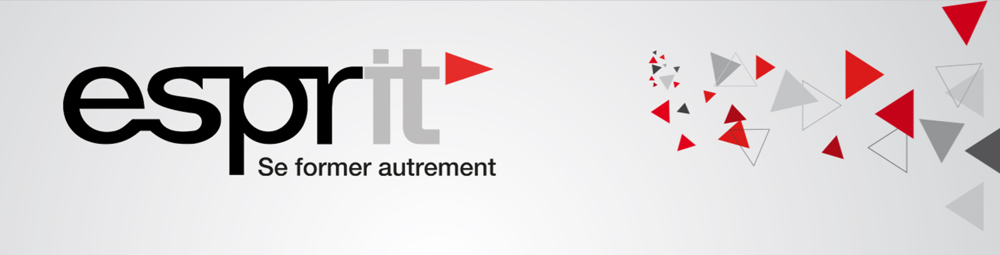

---

<hr> 

<h1 align="center">Projet IA</h1>
<h1> Groupe 5 : </h1>
<3> </3>

<hr> 


**First: We start by imports biblios**

In [56]:
import PyPDF2
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
import re
import string
from nltk.corpus import stopwords, brown
from nltk.tokenize import word_tokenize, sent_tokenize, RegexpTokenizer
from nltk.stem import WordNetLemmatizer
from spacy.matcher import Matcher 
from spacy.tokens import Span 
from spacy import displacy 
import rdflib
from rdflib	import Namespace
from owlready2 import *

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


# 1. Data extraction

**1- Read the document**

In [2]:
import os
open_filename =open("C:/PMBOKGuide_5th_Ed.pdf","rb")
ind_manifesto = PyPDF2.PdfFileReader(open_filename)

**2- Check the document information**

In [3]:
ind_manifesto.getDocumentInfo()

{'/Producer': 'Creo Normalizer JTP',
 '/ModDate': "D:20130221141314+02'00'",
 '/CreationDate': "D:20121220154602-05'00'"}

**3- Check numbers of pages**

In [9]:
total_pages = ind_manifesto.numPages
total_pages

616

In [10]:
#!pip install textract

In [11]:
def extract(subject):
    s=subject.lower()
    if s=="project scope management":
        start= 130
        end= 166
    elif s=="project time management":
        start=166
        end=218  
    else: 
        start=218
        end=252
    text  = ''
    # Lets loop through, to read each page from the pdf file
    while(start < end):
        # Get the specified number of pages in the document
        mani_page  = ind_manifesto.getPage(start)
        # Process the next page
        start += 1
        # Extract the text from the page
        text += mani_page.extractText()
    return text


**-Part of time management**

In [12]:
ptm = extract("project time management")
ptm

'141©2013 Project Management Institute.\n A Guide to the Project Management Body of Knowledge (PMBOK\n® Guide) Œ Fifth Edition \n6 - PROJECT TIME MANAGEMENT6PROJECT TIME MA\nNAGEMENTProject Time Management includes the processes required to manage the timely completion of the project.\n\nFigure 6-1 provides an overview of the Project Time Management processes, which are as follows:\n6.1  Plan Schedule ManagementŠThe process of establishing the policies, procedures, and documentation \n\nfor planning, developing, managing, executing, and controlling the project schedule.\n6.2  Define Activities\nŠThe process of identifying and documenting the speci˜c actions to be performed to produce the project deliverables.6.3  Sequence Activities\nŠThe process of identifying and documenting relationships among the project \n\nactivities.6.4  Estimate Activity ResourcesŠThe process of estimating the type and quantities of material, human \nresources, equipment, or supplies required to perform each ac

**-Part of cost management**

In [13]:
pcm = extract("project cost management")
pcm

'193©2013 Project Management Institute.\n A Guide to the Project Management Body of Knowledge (PMBOK\n® Guide) Œ Fifth Edition \n7 - PROJECT COST MANAGEMENT7PROJECT COST MANAGEMENTProject Cost Management includes the processes involved in planning, estimating, budgeting, ˜nancing, funding, \nmanaging, and controlling costs so that the project can be completed within the approved budget.\nFigure 7-1 provides an overview of the following Project Cost Management processes:\n7.1  Plan Cost ManagementŠThe process that establishes the policies, procedures, and documentation \nfor planning, managing, expending, and controlling project costs.\n7.2  Estimate CostsŠThe process of developing an approximation of the monetary resources needed to \ncomplete project activities.7.3  Determine Budget\nŠThe process of aggregating the estimated costs of individual activities or work \npackages to establish an authorized cost baseline.\n7.4  Control CostsŠThe process of monitoring the status of the projec

**-Part of scope management**

In [14]:
psm=extract("project scope management")
psm

'105©2013 Project Management Institute.\n A Guide to the Project Management Body of Knowledge (PMBOK\n® Guide) Œ Fifth Edition \n5 - PROJECT SCOPE MANAGEMENT5PROJECT SCOPE MANAGEMENTProject Scope Management includes the processes required to ensure that the project includes all the work \nrequired, and only the work required, to complete the project successfully. Managing the project scope is primarily \n\nconcerned with de˜ning and controlling what is and is not included in the project.\nFigure 5-1 provides an overview of the Project Scope Management processes, which include the following:\n5.1  Plan Scope ManagementŠThe process of creating a scope management plan that documents how \n\nthe project scope will be de˜ned, validated, and controlled.\n5.2  Collect RequirementsŠThe process of determining, documenting, and managing stakeholder needs \nand requirements to meet project objectives.5.3 Define ScopeŠThe process of developing a detailed description of the project and product.5.4 

**concatenation**

In [15]:
#concaténation
text=psm+ptm+pcm
text

'105©2013 Project Management Institute.\n A Guide to the Project Management Body of Knowledge (PMBOK\n® Guide) Œ Fifth Edition \n5 - PROJECT SCOPE MANAGEMENT5PROJECT SCOPE MANAGEMENTProject Scope Management includes the processes required to ensure that the project includes all the work \nrequired, and only the work required, to complete the project successfully. Managing the project scope is primarily \n\nconcerned with de˜ning and controlling what is and is not included in the project.\nFigure 5-1 provides an overview of the Project Scope Management processes, which include the following:\n5.1  Plan Scope ManagementŠThe process of creating a scope management plan that documents how \n\nthe project scope will be de˜ned, validated, and controlled.\n5.2  Collect RequirementsŠThe process of determining, documenting, and managing stakeholder needs \nand requirements to meet project objectives.5.3 Define ScopeŠThe process of developing a detailed description of the project and product.5.4 

# 2. Data preprocessing

**removing undesirable and specific characters** 

In [17]:
text=text.replace('\n A Guide to the Project Management Body of Knowledge (PMBOK\n® Guide) Œ Fifth Edition','',123)
text=text.replace('Licensed To: Jorge Diego Fuentes Sanchez PMI MemberID: 2399412This copy is a PMI Member benefit, not for distribution, sale, or reproduction.','',123)
for i in range (105,227):
    text=text.replace(str(i)+'©2013 Project Management Institute.','',123)
text=text.replace('\n5 - PROJECT SCOPE MANAGEMENT5PROJECT SCOPE MANAGEMENT',' ')
text=text.replace('\n6 - PROJECT TIME MANAGEMENT6PROJECT TIME MA\nNAGEMENT',' ')
text=text.replace('˜',' ')
text=text.replace('\n7 - PROJECT COST MANAGEMENT7PROJECT COST MANAGEMENT',' ')
text=text.replace('5.1.3.1 Scope Management Plan',' ')
text = text.replace("\nem", " ").replace("™", "'").replace("˚"," ").replace("œ", " ").replace("š"," ")
text=text.replace('\n',' ') 
text=text.lower()

In [18]:
text

"  project scope management includes the processes required to ensure that the project includes all the work  required, and only the work required, to complete the project successfully. managing the project scope is primarily   concerned with de ning and controlling what is and is not included in the project. figure 5-1 provides an overview of the project scope management processes, which include the following: 5.1  plan scope managementšthe process of creating a scope management plan that documents how   the project scope will be de ned, validated, and controlled. 5.2  collect requirementsšthe process of determining, documenting, and managing stakeholder needs  and requirements to meet project objectives.5.3 define scopešthe process of developing a detailed description of the project and product.5.4  create wbs šthe process of subdividing project deliverables and project work into smaller, more  manageable components. 5.5 validate scope šthe process of formalizing acceptance of the co

## 2.2 Remove undesired ponctuation 

In [14]:
#we just keep . and ? to split sentences then

In [19]:

def remove_punctuation(text):
    # replacing the punctuations with no space, 
    # which in effect deletes the punctuation marks 
    translator = str.maketrans('', '', '!".?#$%&\'()*+,-/:;<=>@[\\]^_`{|}~')
    # return the text stripped of punctuation marks
    return text.translate(translator)

In [20]:
no_ponc=remove_punctuation(text)

## 2.3 Remove stopwords

- we just keep stop words that we will help us to identify the patterns later 

In [21]:
import nltk
import re
corpus=[]
nltk.download('stopwords')
from nltk.corpus import stopwords
sw = set(stopwords.words('english')) -set([
    "you're", "you've", "she's", "it's", 'who', 'whom', 'am',  'is', 'are', 'was', 'were', 'be','been',
    'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing',"a",
    'other', 'some',  'no', 'nor', 'not', 'own', 'same',  's', 't', 'can', 'don', "don't", 'should',
    "should've", 'now', 'd', 'll', 'm', 'o', 're', 've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 
    'didn', "didn't", 'doesn', "doesn't", 'hadn', "hadn't", 'hasn', "hasn't", "haven't", 'isn', "isn't",
    'will','such','as', 'weren', "weren't", 'won', "won't", 'wouldn', "wouldn't",'can'])
def stopwords(text): 
# Removing words that contain numbers
    text= re.sub("\S*\d\S*", " ", text).strip()
    text =re.sub('https?://\S+|www\.\S+', ' ', text)
    text=re.sub("\d+", " ", text)
    text = [word for word in text.split() if word not in sw]
    j=" ".join(text)
    corpus.append(j)

    #text = re.sub("[^a-zA-^Z]", " ", text)
  
    return j

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [22]:
no_stop=stopwords(no_ponc)
no_stop

'project scope management includes processes required ensure project includes work required work required complete project successfully managing project scope is primarily concerned de ning controlling is is not included project figure provides overview project scope management processes include following plan scope managementšthe process creating a scope management plan documents project scope will be de ned validated controlled collect requirementsšthe process determining documenting managing stakeholder needs requirements meet project define scopešthe process developing a detailed description project create wbs šthe process subdividing project deliverables project work smaller manageable components validate scope šthe process formalizing acceptance completed project deliverables control scope šthe process monitoring status project product scope managing changes scope baselinethese processes interact other processes other knowledge areas as described detail section annex project cont

In [19]:
#df = pd.DataFrame(no_stop.split(" "),columns=['text'])


## 2.1 Tokenization

In [23]:
sentences = sent_tokenize(no_stop)
words = word_tokenize(no_stop)

**split sentences and questions**

In [ ]:
def split_sentences(text):
   
    text = re.split('[.?]', text)
    return text

In [25]:
#split_sentences(no_stop)

In [26]:
print(words[:20])

['project', 'scope', 'management', 'includes', 'processes', 'required', 'ensure', 'project', 'includes', 'work', 'required', 'work', 'required', 'complete', 'project', 'successfully', 'managing', 'project', 'scope', 'is']


## 2.4 Lemmetization and Stemming

In [27]:
import gensim
import nltk
nltk.download('wordnet')
from nltk.stem import SnowballStemmer,WordNetLemmatizer
def lemmatize_stemming(text):
    stemmer=SnowballStemmer('english')
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        result.append(lemmatize_stemming(token))
    return result

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [28]:
processed = preprocess(no_stop)
print(processed)

['project', 'scope', 'manag', 'includ', 'process', 'requir', 'ensur', 'project', 'includ', 'work', 'requir', 'work', 'requir', 'complet', 'project', 'success', 'manag', 'project', 'scope', 'be', 'primarili', 'concern', 'de', 'ning', 'control', 'be', 'be', 'not', 'includ', 'project', 'figur', 'provid', 'overview', 'project', 'scope', 'manag', 'process', 'includ', 'follow', 'plan', 'scope', 'managementšth', 'process', 'creat', 'scope', 'manag', 'plan', 'document', 'project', 'scope', 'will', 'be', 'de', 'ned', 'valid', 'control', 'collect', 'process', 'determin', 'document', 'manag', 'stakehold', 'need', 'requir', 'meet', 'project', 'defin', 'scopešth', 'process', 'develop', 'detail', 'descript', 'project', 'creat', 'wbs', 'šthe', 'process', 'subdivid', 'project', 'deliver', 'project', 'work', 'smaller', 'manag', 'compon', 'valid', 'scope', 'šthe', 'process', 'formal', 'accept', 'complet', 'project', 'deliver', 'control', 'scope', 'šthe', 'process', 'monitor', 'status', 'project', 'produ

## 2.5 POS Tagging

- After cleaning and tokenizing the text we will tag each word by its nature

## POS with spacy

In [29]:
# pos with spacy
import en_core_web_sm
nlp = en_core_web_sm.load()

In [30]:
import spacy
#nlp = spacy.load("en_core_web_sm") 

doc1 = nlp(no_stop)

In [31]:
for sent in doc1.sents:
    print(sent)

project scope management includes processes required ensure project includes work required work required complete project successfully managing project scope is primarily concerned de ning controlling is is not included project figure provides overview project scope management processes include following plan scope managementšthe process creating a scope management plan documents project scope will be de ned validated controlled collect requirementsšthe process determining documenting managing stakeholder needs requirements meet project define scopešthe process developing a detailed description project create
wbs šthe process subdividing project deliverables project work smaller manageable components validate scope šthe process formalizing acceptance completed project deliverables control scope šthe process monitoring status project product scope managing changes scope baselinethese processes interact other processes other knowledge areas as described detail section annex project conte

In [29]:
# Token and Tag 
for tok in doc1: 
    # print token, dependency, POS tag 
    print(tok.text, "-->",tok.dep_,"-->", tok.pos_)

project --> compound --> NOUN
scope --> compound --> PROPN
management --> nsubj --> NOUN
includes --> ROOT --> VERB
processes --> dobj --> NOUN
required --> acl --> VERB
ensure --> compound --> ADJ
project --> dobj --> NOUN
includes --> acl --> VERB
work --> nmod --> NOUN
required --> amod --> VERB
work --> dobj --> NOUN
required --> amod --> VERB
complete --> amod --> ADJ
project --> appos --> NOUN
successfully --> advmod --> ADV
managing --> acl --> VERB
project --> compound --> NOUN
scope --> dobj --> NOUN
is --> conj --> AUX
primarily --> advmod --> ADV
concerned --> amod --> ADJ
de --> nmod --> PROPN
ning --> compound --> NOUN
controlling --> nsubj --> NOUN
is --> conj --> AUX
is --> auxpass --> AUX
not --> neg --> PART
included --> conj --> VERB
project --> compound --> NOUN
figure --> nsubj --> NOUN
provides --> ccomp --> VERB
overview --> amod --> ADJ
project --> compound --> NOUN
scope --> compound --> NOUN
management --> compound --> NOUN
processes --> dobj --> NOUN
include -

**100 commonly occurring words with their frequencies**

In [32]:
from collections import Counter
complete_doc = nlp(no_stop)
words = [token.text for token in complete_doc if  not token.is_punct]
word_freq = Counter(words)
# 100 commonly occurring words with their frequencies
common_words = word_freq.most_common(100)
print (common_words)

[('project', 971), ('a', 506), ('is', 442), ('schedule', 408), ('management', 363), ('be', 345), ('cost', 341), ('are', 334), ('scope', 301), ('activity', 288), ('work', 263), ('process', 261), ('as', 246), ('plan', 222), ('requirements', 203), ('section', 182), ('can', 179), ('may', 170), ('activities', 151), ('used', 140), ('resource', 138), ('performance', 134), ('time', 129), ('baseline', 126), ('information', 124), ('techniques', 118), ('not', 116), ('control', 111), ('include', 110), ('wbs', 104), ('will', 101), ('tools', 100), ('estimates', 96), ('data', 94), ('resources', 89), ('costs', 88), ('analysis', 86), ('such', 85), ('figure', 84), ('other', 84), ('estimating', 84), ('organizational', 82), ('duration', 81), ('product', 75), ('estimate', 75), ('limited', 72), ('inputs', 71), ('deliverables', 70), ('value', 70), ('de', 63), ('change', 61), ('planned', 60), ('documents', 59), ('budget', 59), ('assets', 58), ('risk', 58), ('critical', 57), ('required', 56), ('scheduling', 55

**Unique words**

In [33]:
unique_words = [word for (word, freq) in word_freq.items() if freq == 1]
print (unique_words[:10])

['successfully', 'requirementsšthe', 'scopešthe', 'baselinethese', 'characterize', 'managementcompletion', 'scopefigure', 'managemententerprise', 'projectmanagementplanpproject', 'detailing']


**list of Verb tokens**

In [34]:
 print("Verbs:", [token.text for token in doc1 if token.pos_ == "VERB"]) 

Verbs: ['includes', 'required', 'includes', 'required', 'required', 'managing', 'included', 'provides', 'include', 'following', 'creating', 'validated', 'controlled', 'determining', 'documenting', 'managing', 'meet', 'define', 'developing', 'create', 'subdividing', 'work', 'validate', 'formalizing', 'completed', 'control', 'monitoring', 'scope', 'interact', 'described', 'refer', 'features', 'characterize', 'performed', 'deliver', 'features', 'viewed', 'including', 'used', 'supporting', 'vary', 'approved', 'changed', 'used', 'performing', 'controlling', 'measured', 'measured', 'need', 'integrated', 'work', 'result', 'expert', 'requirements', 'inputs', 'requirements', 'techniques', 'focus', 'facilitated', 'questionnaires', 'observations', 'benchmarking', 'requirements', 'expert', 'facilitated', 'updates', 'scope', 'updates', 'requirements', 'verified', 'work', 'accepted', 'work', 'updates', 'requirements', 'work', 'techniques', 'variance', 'work', 'updates', 'updates', 'updates', 'plan',

#  POS with nltk 

- Visualise dependency parse using Displacy (Python)

In [35]:
sen = nlp(no_stop)
displacy.render(sen, style='dep', jupyter=True, options={'distance': 85})

In [36]:
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [37]:
tags=nltk.pos_tag(no_stop.split())

In [38]:
print(tags)

[('project', 'NN'), ('scope', 'NN'), ('management', 'NN'), ('includes', 'VBZ'), ('processes', 'NNS'), ('required', 'JJ'), ('ensure', 'VB'), ('project', 'NN'), ('includes', 'VBZ'), ('work', 'NN'), ('required', 'JJ'), ('work', 'NN'), ('required', 'VBD'), ('complete', 'JJ'), ('project', 'NN'), ('successfully', 'RB'), ('managing', 'VBG'), ('project', 'NN'), ('scope', 'NN'), ('is', 'VBZ'), ('primarily', 'RB'), ('concerned', 'VBN'), ('de', 'IN'), ('ning', 'VBG'), ('controlling', 'NN'), ('is', 'VBZ'), ('is', 'VBZ'), ('not', 'RB'), ('included', 'VBN'), ('project', 'NN'), ('figure', 'NN'), ('provides', 'VBZ'), ('overview', 'NN'), ('project', 'NN'), ('scope', 'NN'), ('management', 'NN'), ('processes', 'VBZ'), ('include', 'VBP'), ('following', 'VBG'), ('plan', 'NN'), ('scope', 'VBP'), ('managementšthe', 'JJ'), ('process', 'NN'), ('creating', 'VBG'), ('a', 'DT'), ('scope', 'NN'), ('management', 'NN'), ('plan', 'NN'), ('documents', 'NNS'), ('project', 'VBP'), ('scope', 'NN'), ('will', 'MD'), ('be',

## 2.6 Chunking with NLTK

- Extract entities and relations between them

- using biblio nltk

#### extract sentences from text having specific patern 

-  we will extract text with specific pattern. So we startedd with a simple pattern which describe a sentence in this format  
 **NN(Noun) + (VBZ)Verb + Adjective(ADJ) + Noun(NN)**

In [39]:
import nltk
#"NP:{<DT>?<JJ>*<NN>}"
grammar="Chunk:{<NN.?><VB.?><JJ>*<NN.?>}"
chunkParser = nltk.RegexpParser(grammar)
chunked = chunkParser.parse(tags)
print(chunked)


(S
  project/NN
  scope/NN
  (Chunk management/NN includes/VBZ processes/NNS)
  required/JJ
  ensure/VB
  (Chunk project/NN includes/VBZ work/NN)
  required/JJ
  (Chunk work/NN required/VBD complete/JJ project/NN)
  successfully/RB
  managing/VBG
  project/NN
  scope/NN
  is/VBZ
  primarily/RB
  concerned/VBN
  de/IN
  ning/VBG
  controlling/NN
  is/VBZ
  is/VBZ
  not/RB
  included/VBN
  project/NN
  (Chunk figure/NN provides/VBZ overview/NN)
  project/NN
  scope/NN
  management/NN
  processes/VBZ
  include/VBP
  following/VBG
  (Chunk plan/NN scope/VBP managementšthe/JJ process/NN)
  creating/VBG
  a/DT
  scope/NN
  management/NN
  plan/NN
  (Chunk documents/NNS project/VBP scope/NN)
  will/MD
  be/VB
  de/FW
  ned/VBN
  validated/VBD
  controlled/JJ
  collect/NN
  requirementsšthe/NN
  process/NN
  determining/VBG
  documenting/VBG
  managing/VBG
  stakeholder/NN
  needs/NNS
  requirements/NNS
  meet/VB
  project/JJ
  define/VB
  scopešthe/JJ
  process/NN
  developing/VBG
  a/DT
  de

In [38]:
#result.draw()

In [40]:
nltk.download('conll2000')
from nltk.corpus import conll2000
from nltk.chunk import ChunkParserI#Define the chunker class
from nltk.chunk.util import tree2conlltags,conlltags2tree
from nltk.tag import UnigramTagger, BigramTagger

data= conll2000.chunked_sents()

[nltk_data] Downloading package conll2000 to
[nltk_data]     C:\Users\amalh\AppData\Roaming\nltk_data...
[nltk_data]   Package conll2000 is already up-to-date!


- the conll2002 Dutch c>orpus contains not just named entity annotation but also part-of-speech tags. This allows us to devise patterns that are sensitive to these tags,

In [41]:
train_data=data[:10900]
test_data=data[10900:]

In [42]:
def conll_tag_chunks(chunk_sents):
    tagged_sents = [tree2conlltags(tree) for tree in chunk_sents]
    return [[(t, c) for (w, t, c) in sent] for sent in tagged_sents]

<hr> 

In [43]:
def combined_tagger(train_data, taggers, backoff=None):
    for tagger in taggers:
        backoff = tagger(train_data, backoff=backoff)
    return backoff

In [44]:

#Define the chunker class
class NGramTagChunker(ChunkParserI):
    
    def __init__(self,train_sentences,tagger_classes=[UnigramTagger,BigramTagger]):
        train_sent_tags=conll_tag_chunks(train_sentences)
        self.chunk_tagger=combined_tagger(train_sent_tags,tagger_classes)
        
    def parse(self,tagged_sentence):
        if not tagged_sentence:
            return None
        
        pos_tags=[tag for word, tag in tagged_sentence]
        chunk_pos_tags=self.chunk_tagger.tag(pos_tags)
        chunk_tags=[chunk_tag for (pos_tag,chunk_tag) in chunk_pos_tags]
        wpc_tags=[(word,pos_tag,chunk_tag) for ((word,pos_tag),chunk_tag) in zip(tagged_sentence,chunk_tags)]
        
        return conlltags2tree(wpc_tags)        

In [45]:

ntc=NGramTagChunker(train_data)

#evaluate chunker model performance
print(ntc.evaluate(test_data))

ChunkParse score:
    IOB Accuracy:  90.0%%
    Precision:     82.1%%
    Recall:        86.3%%
    F-Measure:     84.1%%


## 2.7 Bag of words

In [46]:
import gensim
from gensim import corpora


# turn our tokenized documents into a id <-> term dictionary
dictionary = corpora.Dictionary([no_stop.split()])
# convert tokenized documents into a document-term matrix
bow_corpus = [dictionary.doc2bow(text) for text in [no_stop.split()]]

In [47]:
print(bow_corpus)

[[(0, 506), (1, 1), (2, 3), (3, 4), (4, 1), (5, 24), (6, 1), (7, 9), (8, 19), (9, 14), (10, 1), (11, 1), (12, 3), (13, 11), (14, 1), (15, 1), (16, 1), (17, 3), (18, 20), (19, 5), (20, 10), (21, 1), (22, 1), (23, 20), (24, 8), (25, 1), (26, 1), (27, 2), (28, 4), (29, 4), (30, 1), (31, 1), (32, 2), (33, 1), (34, 1), (35, 1), (36, 18), (37, 12), (38, 2), (39, 151), (40, 1), (41, 1), (42, 288), (43, 1), (44, 3), (45, 2), (46, 1), (47, 4), (48, 3), (49, 49), (50, 4), (51, 1), (52, 5), (53, 1), (54, 1), (55, 21), (56, 2), (57, 4), (58, 2), (59, 2), (60, 2), (61, 4), (62, 1), (63, 1), (64, 2), (65, 1), (66, 1), (67, 1), (68, 1), (69, 1), (70, 1), (71, 1), (72, 1), (73, 13), (74, 2), (75, 1), (76, 1), (77, 1), (78, 2), (79, 9), (80, 4), (81, 2), (82, 1), (83, 3), (84, 3), (85, 2), (86, 5), (87, 4), (88, 1), (89, 1), (90, 6), (91, 1), (92, 1), (93, 1), (94, 1), (95, 1), (96, 3), (97, 4), (98, 1), (99, 4), (100, 3), (101, 1), (102, 2), (103, 3), (104, 5), (105, 12), (106, 45), (107, 8), (108, 8)

In [47]:
list(dictionary.values())

['a',
 'abbreviated',
 'ability',
 'able',
 'abstract',
 'ac',
 'accelerating',
 'acceptable',
 'acceptance',
 'accepted',
 'accepts',
 'accompany',
 'accomplish',
 'accomplished',
 'accomplishing',
 'accomplishment',
 'accordance',
 'according',
 'account',
 'accounting',
 'accounts',
 'accumulate',
 'accumulated',
 'accuracy',
 'accurate',
 'accurately',
 'acd',
 'achievable',
 'achieve',
 'achieved',
 'achieving',
 'acknowledging',
 'acquired',
 'acquisition',
 'across',
 'acted',
 'action',
 'actions',
 'active',
 'activities',
 'activitiesde',
 'activitiessequence',
 'activity',
 'activitydurationsa',
 'activityidentifier',
 'activityonnode',
 'activityresourcesfigure',
 'activitys',
 'actors',
 'actual',
 'actually',
 'adapt',
 'added',
 'adding',
 'addition',
 'additional',
 'additionally',
 'address',
 'addressed',
 'adds',
 'adjust',
 'adjusted',
 'adjusting',
 'adjustment',
 'adjustments',
 'adjusts',
 'administration',
 'administrationtraining',
 'advance',
 'advanced',
 'ad

In [48]:
bow_doc_0 = bow_corpus[0]
for i in range(len(bow_doc_0)):
    print("Word {} (\"{}\") appears {} time.".format(bow_doc_0[i][0], 
                                               dictionary[bow_doc_0[i][0]], 
bow_doc_0[i][1]))

Word 0 ("a") appears 506 time.
Word 1 ("abbreviated") appears 1 time.
Word 2 ("ability") appears 3 time.
Word 3 ("able") appears 4 time.
Word 4 ("abstract") appears 1 time.
Word 5 ("ac") appears 24 time.
Word 6 ("accelerating") appears 1 time.
Word 7 ("acceptable") appears 9 time.
Word 8 ("acceptance") appears 19 time.
Word 9 ("accepted") appears 14 time.
Word 10 ("accepts") appears 1 time.
Word 11 ("accompany") appears 1 time.
Word 12 ("accomplish") appears 3 time.
Word 13 ("accomplished") appears 11 time.
Word 14 ("accomplishing") appears 1 time.
Word 15 ("accomplishment") appears 1 time.
Word 16 ("accordance") appears 1 time.
Word 17 ("according") appears 3 time.
Word 18 ("account") appears 20 time.
Word 19 ("accounting") appears 5 time.
Word 20 ("accounts") appears 10 time.
Word 21 ("accumulate") appears 1 time.
Word 22 ("accumulated") appears 1 time.
Word 23 ("accuracy") appears 20 time.
Word 24 ("accurate") appears 8 time.
Word 25 ("accurately") appears 1 time.
Word 26 ("acd") ap

# Data analysis

## 3.1 TF-ID

In [49]:
sentences

['project scope management includes processes required ensure project includes work required work required complete project successfully managing project scope is primarily concerned de ning controlling is is not included project figure provides overview project scope management processes include following plan scope managementšthe process creating a scope management plan documents project scope will be de ned validated controlled collect requirementsšthe process determining documenting managing stakeholder needs requirements meet project define scopešthe process developing a detailed description project create wbs šthe process subdividing project deliverables project work smaller manageable components validate scope šthe process formalizing acceptance completed project deliverables control scope šthe process monitoring status project product scope managing changes scope baselinethese processes interact other processes other knowledge areas as described detail section annex project con

In [50]:
#instantiate CountVectorizer() 
from sklearn.feature_extraction.text import TfidfTransformer 
from sklearn.feature_extraction.text  import CountVectorizer
cv=CountVectorizer() 
# this steps generates word counts for the words in your docs 
word_count_vector=cv.fit_transform(sentences)
word_count_vector.shape

(1, 2530)

In [51]:
tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True) 
tfidf_transformer.fit(word_count_vector)

TfidfTransformer()

In [52]:
# print idf values 
import pandas as pd
df_idf = pd.DataFrame(tfidf_transformer.idf_, index=cv.get_feature_names(),columns=["idf_weights"]) 
# sort ascending 
df_idf.sort_values(by=['idf_weights'])

,idf_weights
abbreviated,1.0
plant,1.0
planthe,1.0
players,1.0
pleting,1.0
...,...
estimatingbottomup,1.0
estimation,1.0
etc,1.0
estimatesdescribed,1.0


In [53]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(sentences)
print(vectorizer.get_feature_names())

['abbreviated', 'ability', 'able', 'abstract', 'ac', 'accelerating', 'acceptable', 'acceptance', 'accepted', 'accepts', 'accompany', 'accomplish', 'accomplished', 'accomplishing', 'accomplishment', 'accordance', 'according', 'account', 'accounting', 'accounts', 'accumulate', 'accumulated', 'accuracy', 'accurate', 'accurately', 'acd', 'achievable', 'achieve', 'achieved', 'achieving', 'acknowledging', 'acquired', 'acquisition', 'across', 'acted', 'action', 'actions', 'active', 'activities', 'activitiesde', 'activitiessequence', 'activity', 'activitydurationsa', 'activityidentifier', 'activityonnode', 'activityresourcesfigure', 'activitys', 'actors', 'actual', 'actually', 'adapt', 'added', 'adding', 'addition', 'additional', 'additionally', 'address', 'addressed', 'adds', 'adjust', 'adjusted', 'adjusting', 'adjustment', 'adjustments', 'adjusts', 'administration', 'administrationtraining', 'advance', 'advanced', 'adverse', 'advertising', 'aeliverables', 'affect', 'affecting', 'affects', 'a

## 3.2 Distance similarity 

In [54]:
def LevenshteinDistance():
  edDictio={}
  for word in processed:
    a=np.random.choice(processed)
    b=np.random.choice(processed)
    ed_sent=nltk.edit_distance(a,b)
    edDictio[a,b]=ed_sent
  print(edDictio)

In [57]:
LevenshteinDistance()

{('howev', 'day'): 5, ('hour', 'be'): 4, ('ned', 'schedul'): 5, ('budget', 'baselin'): 6, ('project', 'present'): 3, ('priorit', 'phase'): 6, ('be', 'project'): 6, ('singl', 'monitor'): 6, ('determin', 'tm'): 6, ('coordin', 'project'): 6, ('major', 'activ'): 5, ('cost', 'have'): 4, ('can', 'analyz'): 5, ('critic', 'histor'): 5, ('data', 'collect'): 7, ('status', 'project'): 7, ('data', 'add'): 3, ('cost', 'project'): 5, ('project', 'tocomplet'): 7, ('schedul', 'time'): 6, ('plan', 'prevent'): 5, ('manag', 'extern'): 6, ('can', 'project'): 7, ('diagram', 'plan'): 6, ('lag', 'other'): 5, ('sponsor', 'total'): 6, ('cost', 'knowledg'): 7, ('identifi', 'start'): 7, ('manag', 'suppli'): 6, ('mileston', 'such'): 7, ('cost', 'number'): 6, ('have', 'work'): 4, ('base', 'project'): 6, ('limit', 'obtain'): 5, ('deliver', 'monitor'): 5, ('need', 'refer'): 3, ('use', 'examin'): 6, ('document', 'project'): 6, ('softwar', 'produc'): 7, ('deliver', 'method'): 6, ('indirect', 'figur'): 7, ('may', 'proj

## 3.4 World cloud

**Get 100 words based on the bags of words**

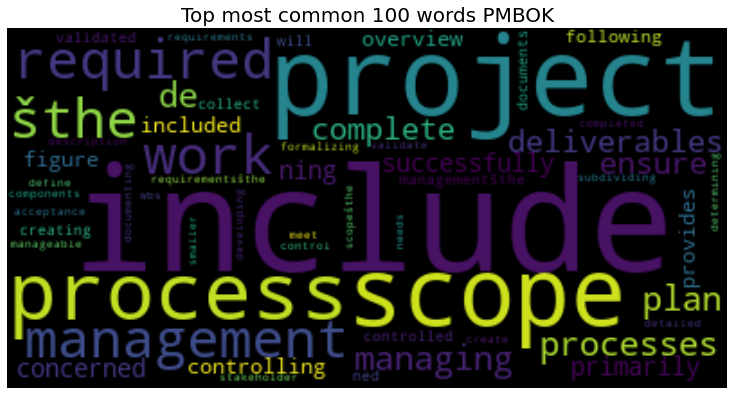

In [58]:
from wordcloud import WordCloud, STOPWORDS
import imageio
import matplotlib.pyplot as plt
import nltk


# Get 100 words based on the 
words_except_stop_dist = nltk.FreqDist(w for w in words[:100]) 
wordcloud = WordCloud(stopwords=set(STOPWORDS),background_color='black').generate(" ".join(words_except_stop_dist))
plt.imshow(wordcloud,interpolation = 'bilinear')
fig=plt.gcf()
fig.set_size_inches(10,12)
plt.axis('off')
plt.title("Top most common 100 words PMBOK",fontsize=20)
plt.tight_layout(pad=0)
plt.savefig('PMBOK_cost_time_scop_top_100.jpeg')

- we note that project , scope , management , process are the most important words in our data so we must find them in the ontologie

<hr>

<h1 align="center"> Synonym </h1>

<hr>

In [59]:
AllConcepts=[]
AllRelations=[]
for tok in doc1:
    if tok.pos_=="NOUN":
        AllConcepts.append(tok.text)
    if tok.pos_=="VERB":
        AllRelations.append(tok.text)
        

- find_synonym_ontology(word) : returns all the synonyms of a word even the synonyms that doesn't exist in PMBOK


In [60]:
from nltk.corpus import wordnet
def find_synonym_ontology(word):
    synonyms = []
    for syn in wordnet.synsets(word):
        for lm in syn.lemmas():
            synonyms.append(lm.name())
    return list(set(synonyms))



In [61]:
# Examples
print("Synonyms of project : ", find_synonym_ontology("project"))
print("Synonyms of management: ", find_synonym_ontology("management"))
print("Synonyms of change: ", find_synonym_ontology("change"))

Synonyms of project :  ['cast', 'visualise', 'throw', 'fancy', 'see', 'visualize', 'picture', 'jut', 'labor', 'send_off', 'undertaking', 'figure', 'projection', 'contrive', 'propose', 'stick_out', 'design', 'protrude', 'envision', 'externalise', 'externalize', 'jut_out', 'project', 'task', 'plan', 'image']
Synonyms of management:  ['management', 'direction']
Synonyms of change:  ['deepen', 'change', 'alter', 'modify', 'vary', 'commute', 'shift', 'interchange', 'convert', 'modification', 'variety', 'alteration', 'transfer', 'switch', 'exchange']


-  returns all the synonyms of a word even the synonyms that exists in PMBOK this method is for concepts

In [62]:
def synonymConceptOntoPMB(term):

    if term not in AllConcepts :
        return "it haven't" 
    else :
        syno_list=[]
        temp_list=[]
        syno_list = find_synonym_ontology(term)
        if len(syno_list) != 0 :
            for syno  in syno_list :
                if syno in AllConcepts  and syno != term :
                    temp_list.append(syno)
                    
        return temp_list

In [63]:
print("Synonym of project in our ontology :", synonymConceptOntoPMB('project'))
print("Synonym of scope in our ontology :", synonymConceptOntoPMB('scope'))

Synonym of project in our ontology : ['labor', 'figure', 'projection', 'design', 'plan']
Synonym of scope in our ontology : ['reach', 'range']


-  returns all the synonyms of a word even the synonyms that exists in PMBOK : this methode for the relations

In [64]:
def synonymrelationOntoPMB(term):
    
    if term not in AllRelations :
        return "it haven't"
    else :
        syno_list=[]
        temp_list=[]
        syno_list = find_synonym_ontology(term)
        if len(syno_list) != 0 :
            for syno  in syno_list :
                if syno in AllRelations  and syno != term :
                    temp_list.append(syno)
                    
        return temp_list

In [65]:
print("Synonym of work in our ontology :", synonymrelationOntoPMB('work'))
print("Synonym of work in our ontology :", synonymrelationOntoPMB('build'))
print("Synonym of work in our ontology :", synonymrelationOntoPMB('create'))

Synonym of work in our ontology : ['bring', 'make', 'form', 'process']
Synonym of work in our ontology : ['construct', 'make', 'establish', 'figure', 'form', 'progress']
Synonym of work in our ontology : ['produce', 'make']


<hr>

<h1 align="center"> Extraction Triple </h1>

<hr>

In [66]:
def triple():
    Triple=[]
    try:
        for subtree in chunked.subtrees(filter=lambda t: t.label() == 'Chunk'):
              Triple.append(subtree)
    except Exception as e:
        print(str(e))
    
    return Triple

In [67]:
print(len(triple()))


1649


<hr>

# Extract Patterns (concepts , relation , object)

<hr>

**Here we user spacy and matcher from spacy**

In [85]:
from spacy.matcher import Matcher 
from spacy.tokens import Span 
from spacy import displacy 

- first we extract Concepts ,relations , objects

In [68]:
Concepts=[]
relation=[]
object=[]
for i in range(len(triple())-1):
    Concepts.append(triple()[i][0][0])
    relation.append(triple()[i][1][0])
    object.append(triple()[i][2][0])
obj= pd.DataFrame(columns=['Concepts','relation','object'])
obj['Concepts']=Concepts
obj['relation']=relation
obj['object']=object

- we remove the duplicates rows

In [69]:
obj.drop_duplicates().reset_index(drop=True)

,Concepts,relation,object
0,management,includes,processes
1,project,includes,work
2,work,required,complete
3,figure,provides,overview
4,plan,scope,managementšthe
...,...,...,...
1311,cases,cost,variances
1312,changes,control,thresholds
1313,accuracy,required,managing
1314,basis,estimates,organizational


In [70]:
list(obj["Concepts"])

['management',
 'project',
 'work',
 'figure',
 'plan',
 'documents',
 'create',
 'process',
 'scope',
 'scope',
 'scope',
 'wbs',
 'comparison',
 'area',
 'scope',
 'plan',
 'assets',
 'plan',
 'plan',
 'plan',
 'interviews',
 'group',
 'prototypes',
 'analysis',
 'traceability',
 'plan',
 'requirements',
 'assets',
 'generation',
 'outputs',
 'documents',
 'plan',
 'documentation',
 'assets',
 'decomposition',
 'outputs',
 'documents',
 'deliverables',
 'group',
 'outputs',
 'requests',
 'documents',
 'traceability',
 'assets',
 'plan',
 'requirements',
 'documents',
 'figure',
 'tools',
 'plan',
 'assets',
 'plan',
 'plan',
 'plan',
 'plan',
 'scope',
 'information',
 'plans',
 'information',
 'plan',
 'section',
 'plans',
 'scope',
 'project',
 'context',
 'processes',
 'factors',
 'plan',
 'culture',
 'process',
 'plan',
 'policies',
 'lessons',
 'plan',
 'tools',
 'plans',
 'meetings',
 'plan',
 'sponsor',
 'members',
 'management',
 'plan',
 'outputs',
 'plan',
 'input',
 'plan'

In [71]:
len(obj)

1648

**we add filter to remove all concepts and objects that have len<=3**

In [72]:
obj=obj[(obj.Concepts.str.len() > 3)]
obj=obj[(obj.object.str.len() >3)]

In [73]:
obj

,Concepts,relation,object
0,management,includes,processes
1,project,includes,work
2,work,required,complete
3,figure,provides,overview
4,plan,scope,managementšthe
...,...,...,...
1643,cases,cost,variances
1644,changes,control,thresholds
1645,accuracy,required,managing
1646,basis,estimates,organizational


In [74]:
common_words = word_freq.most_common(100)
print (common_words)

[('project', 971), ('a', 506), ('is', 442), ('schedule', 408), ('management', 363), ('be', 345), ('cost', 341), ('are', 334), ('scope', 301), ('activity', 288), ('work', 263), ('process', 261), ('as', 246), ('plan', 222), ('requirements', 203), ('section', 182), ('can', 179), ('may', 170), ('activities', 151), ('used', 140), ('resource', 138), ('performance', 134), ('time', 129), ('baseline', 126), ('information', 124), ('techniques', 118), ('not', 116), ('control', 111), ('include', 110), ('wbs', 104), ('will', 101), ('tools', 100), ('estimates', 96), ('data', 94), ('resources', 89), ('costs', 88), ('analysis', 86), ('such', 85), ('figure', 84), ('other', 84), ('estimating', 84), ('organizational', 82), ('duration', 81), ('product', 75), ('estimate', 75), ('limited', 72), ('inputs', 71), ('deliverables', 70), ('value', 70), ('de', 63), ('change', 61), ('planned', 60), ('documents', 59), ('budget', 59), ('assets', 58), ('risk', 58), ('critical', 57), ('required', 56), ('scheduling', 55

**We keep  only the common concepts**

In [169]:
df_concept=list(obj["Concepts"])
for i in df_concept:
    if i not in common_words:
        df_concept.remove(i)
#print(df_concept)
print(len(df_concept))
df_concept=set(df_concept)



763


# Concepts : df_concept

In [205]:
print(len(df_concept))
df_concept

10


,named entity
0,org
1,person
2,gpe
3,cardinal
4,date
5,ordinal
6,fac
7,norp
8,time
9,quantity


<hr>

- we define all patterns that can be an (instance , subclass)

In [206]:
relations = ['is a','such as','kind of','including','have','part','member','instance','and or other','especially','like','in']

## we define All pattern here

In [207]:
#define the pattern 
patternISA = [  {'DEP':'amod','OP':"?"}, # adjectival modifier
                {'POS':'NOUN'}, 
                {'LOWER': 'is'},  {'LOWER': 'a'}, 
                {'POS': 'NOUN'}]
# Pattern such as
pattern2 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
              {'LOWER': 'such'},  {'LOWER': 'as'},
              {'POS':'PROPN'}]
# Pattern kind of
pattern3 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
            {'LOWER': 'kind'},  {'LOWER': 'of'}, 
              {'POS':'PROPN'}]
# Pattern include 
pattern4 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
           {'LOWER': 'include'}, 
              {'DEP':'amod','OP':"?"}, # adjectival modifier 
            {'POS':'NOUN'}]
# Pattern have
pattern5 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
           {'LOWER': 'have'}, 
              {'DEP':'amod','OP':"?"}, # adjectival modifier 
           {'POS':'NOUN'}]
# Pattern part
pattern6 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
           {'LOWER': 'part'}, 
              {'DEP':'amod','OP':"?"}, # adjectival modifier 
           {'POS':'NOUN'}]
# Pattern member
pattern7 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
           {'LOWER': 'member'}, 
              {'DEP':'amod','OP':"?"}, # adjectival modifier 
           {'POS':'NOUN'}]
# Pattern instance
pattern8 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
           {'LOWER': 'instance'}, 
              {'DEP':'amod','OP':"?"}, # adjectival modifier 
           {'POS':'NOUN'}]

#define the pattern  and|or 
pattern9 = [{'DEP':'amod', 'OP':"?"}, 
           {'POS':'NOUN'}, 
           {'LOWER': 'and', 'OP':"?"}, 
           {'LOWER': 'or', 'OP':"?"}, 
           {'LOWER': 'other'}, 
           {'POS': 'NOUN'}] 
# Pattern especially
pattern10 = [  {'DEP':'amod','OP':"?"}, # adjectival modifier 
              {'POS':'NOUN'}, 
           {'LOWER': 'especially'}, 
              {'DEP':'amod','OP':"?"}, # adjectival modifier 
           {'POS':'NOUN'}]
# Pattern like
pattern11 = [{'DEP':'compound', 'OP':"*"},
           {'POS':'NOUN'},
           {'LOWER': 'like'},
           {'DEP':'compound', 'OP':"*"},
           {'POS': 'NOUN'}]
# Pattern In
pattern11 = [{'DEP':'compound', 'OP':"*"},
           {'POS':'NOUN'},
           {'LOWER': 'In'},
           {'DEP':'compound', 'OP':"*"},
           {'POS': 'NOUN'}]

- Let’s extract those patterns from the text:



In [208]:
matcher = Matcher(nlp.vocab) 
matcher.add("All match", None, patternISA,pattern2,pattern3,pattern4,pattern5,pattern6,pattern7,pattern8,pattern10,pattern11)
matchess = matcher(doc1)
spans = [doc1[start:end] for _, start, end in matchess]

In [209]:
spans

[plan include project,
 requirements include conditions,
 cations include business,
 examples include processes,
 effective examples include reliability,
 examples include reliability,
 hidden prototypesprototyping is a method,
 prototypesprototyping is a method,
 industries such as lm,
 matrix is a grid,
 generation is a technique,
 decompositiondecomposition is a technique,
 popular methods include top approach,
 methods include top approach,
 baseline include project,
 account is a management,
 package is a work,
 different terms have unique speci,
 terms have unique speci,
 process include documents,
 analysis is a technique,
 requests have effect,
 requests have effect,
 model is a representation,
 projects especially smaller scope,
 plan is a subsidiary,
 methods include critical path,
 decompositiondecomposition is a technique,
 higher level is a form,
 level is a form,
 distinct milestones have durations,
 milestones have durations,
 project include activity,
 list is a list,
 

In [210]:
X_Relation_Y=[]
for span in spacy.util.filter_spans(spans):
    X_Relation_Y.append(re.split('( include )',span.text))
    #X_Relation_Y.append(re.split('( such as )',span.text))
   # X_Relation_Y.append(re.split('( have )',span.text))
    #X_Relation_Y.append(re.split('( is a )',span.text))
   # X_Relation_Y.append(re.split('( part )',span.text))
   # X_Relation_Y.append(re.split('( like )',span.text))
    
   # 'is a','such as','kind of','including','have','part','member','instance','and or other','especially','like','in'
df_X_Relation_Y = pd.DataFrame(X_Relation_Y,columns=['Y','Relation','X'])
df_X_Relation_Y

,Y,Relation,X
0,plan,include,project
1,requirements,include,conditions
2,cations,include,business
3,examples,include,processes
4,effective examples,include,reliability
5,hidden prototypesprototyping is a method,None,None
6,industries such as lm,None,None
7,matrix is a grid,None,None
8,generation is a technique,None,None
9,decompositiondecomposition is a technique,None,None


In [211]:
df_ind2 = df_X_Relation_Y[['X','Y']].drop_duplicates().reset_index(drop=True).rename(columns={'X':'individual','Y':'concept'})
df_ind2.head()
df_ind2 = df_ind2[['concept']].drop_duplicates().reset_index(drop=True)
df_ind2

,concept
0,plan
1,requirements
2,cations
3,examples
4,effective examples
5,hidden prototypesprototyping is a method
6,industries such as lm
7,matrix is a grid
8,generation is a technique
9,decompositiondecomposition is a technique


In [224]:
df_ind2.head(2)
df_con2 = df_ind2[['concept']].drop_duplicates().reset_index(drop=True)

In [225]:
d = []
for ent in doc1.ents:
    d.append((ent.label_, ent.text))
    df_entity = pd.DataFrame(d, columns=('named entity', 'output'))
df_entity.head()

,named entity,output
0,ORG,de ned
1,ORG,ed features
2,ORG,ed development scope management
3,ORG,de ned
4,ORG,ed


In [226]:
df_concept = df_entity[['named entity']].drop_duplicates().reset_index(drop=True)
df_concept['named entity'] = df_concept['named entity'].str.lower().drop_duplicates()
df_concept.sample(n=2)

,named entity
7,norp
5,ordinal


In [227]:
df_entity.sample(n=2)

,named entity,output
217,PERSON,ac bac
50,ORG,de nes process


<hr>

In [228]:
df_individual = df_entity.drop_duplicates().reset_index(drop=True)
df_individual['concept'] = df_individual['named entity'].str.lower()
df_individual['individual'] = df_individual['output'].str.lower()
df_individual = df_individual.drop(['named entity','output'], axis=1).sort_values('concept').drop_duplicates().reset_index(drop=True)
df_individual.sample(n=5)

,concept,individual
1,cardinal,three
73,org,control reserve analysis
104,person,ﬁunknownunknownsﬂ
50,org,reserve analysis budget reserve analysis
92,person,ed


In [229]:
df_individual=df_individual.reset_index(drop=True).dropna()
df_individual

,concept,individual
0,cardinal,four
1,cardinal,three
2,cardinal,zero
3,cardinal,twelve
4,cardinal,two
...,...,...
108,person,dictionary
109,quantity,hours meters divided meters per hour
110,time,hours
111,time,hour


In [230]:
df_individual = df_individual.append([df_ind2]).drop_duplicates().reset_index(drop=True)
df_individual
df_individual=df_individual.dropna()
df_individual.reset_index(drop=True)

,concept,individual
0,cardinal,four
1,cardinal,three
2,cardinal,zero
3,cardinal,twelve
4,cardinal,two
...,...,...
108,person,dictionary
109,quantity,hours meters divided meters per hour
110,time,hours
111,time,hour


In [231]:
df_individual.sample(n=5)

,concept,individual
68,org,meetingsuser documentation user documentation ...
15,date,quarterly
90,person,pert pert
22,fac,evm metric
59,org,ed features


In [232]:
df_entity.head(2)


,named entity,output
0,ORG,de ned
1,ORG,ed features


In [233]:
df_con2.head(2)

,concept
0,plan
1,requirements


In [234]:
df_concept = df_concept.append([df_con2]).drop_duplicates().reset_index(drop=True)
df_concept.head(2)

,named entity,concept
0,org,NaN
1,person,NaN


In [235]:
df_individual.sample(n=3)

,concept,individual
79,person,activityonnode aon
15,date,quarterly
107,person,ac


In [236]:
#We will keep on unique objects
df_data = obj[obj['object'].isin(df_individual['individual'])].drop_duplicates().reset_index(drop=True)
df_data.sample(n=5)

,Concepts,relation,object
0,requirements,stakeholder,register
5,calendars,risk,register
8,weeks,±,days
11,dates,baseline,nish
1,structures,œ,second


In [237]:
df_data['Concepts']

0      requirements
1        structures
2        activities
3             group
4          activity
5         calendars
6     listsactivity
7           updates
8             weeks
9          activity
10           figure
11            dates
12             date
13          example
14          project
15     deliverables
Name: Concepts, dtype: object

In [238]:
def prefix_ind(w):
    for i in range(len(df_individual)):
        if df_individual.loc[i,'individual'] == w:
            return df_individual.loc[i,'concept']+'_'+w
    return w

df_data['Subject'] = df_data['Concepts'].apply(prefix_ind)

In [239]:
df_data.sample(n=8)

,Concepts,relation,object,Subject
2,activities,wbs,dictionary,activities
9,activity,start,nish,activity
8,weeks,±,days,weeks
10,figure,is,days,figure
4,activity,attributes,milestone,activity
14,project,modeling,techniquesdescribed,project
3,group,decisionmaking,techniquesdescribed,group
6,listsactivity,attributes,milestone,listsactivity


In [240]:
df_data['Range'] = "string"
df_data.drop_duplicates().reset_index(drop=True)

,Concepts,relation,object,Subject,Range
0,requirements,stakeholder,register,requirements,string
1,structures,œ,second,structures,string
2,activities,wbs,dictionary,activities,string
3,group,decisionmaking,techniquesdescribed,group,string
4,activity,attributes,milestone,activity,string
5,calendars,risk,register,calendars,string
6,listsactivity,attributes,milestone,listsactivity,string
7,updates,risk,register,updates,string
8,weeks,±,days,weeks,string
9,activity,start,nish,activity,string


## Subclass/concepts

- we extract the relations that means subclass/class relations

In [241]:
df_parentsuch=[]
df_parentsisa=[]
for span in spacy.util.filter_spans(spans):
    df_parentsuch.append(re.split('( such as )',span.text))  # 'is a','such as','kind of','including','have','part','member','instance','and or other','especially','like','in'
    df_parentsisa.append(re.split('( is a )',span.text))  # 'is a','such as','kind of','including','have','part','member','instance','and or other','especially','like','in'
df_parentsisa = pd.DataFrame(df_parentsisa,columns=['x','parent','y'])
df_parentsuch = pd.DataFrame(df_parentsuch,columns=['x','parent','y'])

In [242]:
df_parentsisa.sample(n=5)

,x,parent,y
19,model,is a,representation
17,requests have effect,None,None
1,requirements include conditions,None,None
48,goal such as bac,None,None
21,plan,is a,subsidiary


- we remove the same concept and predicat

In [243]:
dfParents = pd.concat([df_parentsisa,df_parentsuch], axis=0)
dfParents.sample(n=5)
row_ids = dfParents[dfParents["x"] == dfParents["y"]].index
row_ids
dfParents.drop(row_ids)
dfParents.dropna( inplace=True)

In [244]:
dfParents.head(4)

,x,parent,y
5,hidden prototypesprototyping,is a,method
7,matrix,is a,grid
8,generation,is a,technique
9,decompositiondecomposition,is a,technique


In [245]:
ff=(list(dfParents["x"]))

In [246]:
# Token and Tag 
for tok in nlp(ff[9]): 
    # print token, dependency, POS tag 
    print(tok.text, "-->",tok.dep_,"-->", tok.pos_)

decompositiondecomposition --> ROOT --> NOUN


<hr> 

<hr>

# OWL with rdflib

In [276]:
from rdflib.namespace import DC, DCTERMS, DOAP, FOAF, OWL, RDF, RDFS, SKOS, VOID, XMLNS, XSD
from rdflib import URIRef, BNode, Literal, Namespace, Graph
from rdflib.extras import describer
import pandas as pd 

- create a Graph

In [277]:

g= Graph()
g.bind("owl",OWL)
g.bind("pr","http://example.com/h#")#Bind prefix to namespace
ns_url = "http://example.com/h#"
# Create an RDF URI node to use as the subject for multiple triples
g.add((URIRef('http://example.com/h'), RDF.type, OWL.Ontology ))

- we start by create concepts

## Create concept

In [278]:
for c in df_concept:
    cl = URIRef(ns_url+c.replace(" ","_"))
    g.add((cl, RDF.type, OWL.Class))    # add tag


In [279]:
#for i in range(len(df_concept)):
  #  print(df_concept.loc[i,'relation'])

## create individuel and concept

In [280]:
df_individual.sample(n=5)

,concept,individual
68,org,meetingsuser documentation user documentation ...
40,org,ac bottomup
27,gpe,pv
15,date,quarterly
56,org,horizontal axis


In [281]:
for i in range(len(df_individual)):
    c = URIRef(ns_url+df_individual.loc[i,'concept'].replace(" ","_"))
    ind =URIRef(ns_url+df_individual.loc[i,'individual'].replace(" ","_"))
    g.add((ind,RDF.type,c))

# create concept_instance

In [282]:
dfParents.head(2)

,concept,parent,parent concept
5,hidden prototypesprototyping,is a,method
7,matrix,is a,grid


In [283]:
dfParents=dfParents.rename(columns={'x':'concept','y':'parent concept'})

In [284]:
type(dfParents)

pandas.core.frame.DataFrame

In [286]:
for c in df_concept :
    cl = URIRef(ns_url+c.replace(" ","_"))
    g.add((cl, RDF.type, OWL.Class))
    for i in dfParents.index:
        if dfParents.loc[i,'concept'] == c:
            clp = URIRef(ns_url+dfParents.loc[i,'parent concept'].replace(" ","_"))
            g.add((cl, RDFS.subClassOf, clp))

# create Relation dtaa property

In [287]:
df_data.head(1)

,Concepts,relation,object,Subject,Range
0,requirements,stakeholder,register,requirements,string


In [288]:
for i in range(len(df_data)):
    c = URIRef(ns_url+df_data.loc[i,'relation'].replace(" ","_"))
    domaine = URIRef(ns_url+df_data.loc[i,'Concepts'].replace(" ","_"))
    g.add((c,RDF.type,OWL.DatatypeProperty))
    g.add((c,RDFS.domain,domaine))
    g.add((c,RDFS.range,XSD.string))

In [289]:
with open('onto1.owl', 'w', encoding='utf-8') as output:
    output.write(g.serialize(format="pretty-xml").decode("utf-8"))

<hr>

# Ontologie owlready

- In this section we just  did a search to understand the owlready2

In [261]:
onto1= owlready2.get_ontology('http://www.lesfleursdunormal.fr/static/_downloads/pizza_onto.owl')
onto1.load()

get_ontology("http://www.lesfleursdunormal.fr/static/_downloads/pizza_onto.owl#")

In [262]:
x=obj["Concepts"].drop_duplicates()
L=[]
for i in x:
    L.append(i)

In [263]:
#create classes

In [264]:
for i  in L:
    kkk=str(i)
    with onto1:
        class kkk(Thing): pass
        #print(kkk)
#print(list(onto1.classes()))

In [1]:
#with onto:
    
   # class has_for_synonym(DataProperty):
    #    range = [str]

In [266]:
with onto:
    for i in range(len(triple())-1):
        f= triple()[i][1][0]
        print(i)
    class f(ObjectProperty): 
        domain    = [triple()[i][1][0]]#[
        range     = [triple()[i][2][0]]#

NameError: name 'onto' is not defined

In [267]:
#ontolo.destroy

In [268]:
for i in list(ontolo.classes()):
    print(i)

NameError: name 'ontolo' is not defined

In [269]:
with ontolo:
    class has_for_synonym(DataProperty):
        range = [str]

NameError: name 'ontolo' is not defined

In [270]:
project.has_for_synonym = ["work"]

NameError: name 'project' is not defined

In [76]:
Person(?x), hasParent(?x, ?y), hasParent(?x, ?z), hasSpouse(?y, ?z) -> ChildOfMarriedParents(?x)

    

SyntaxError: invalid syntax (<ipython-input-76-2b9e9c1df44c>, line 1)